In [1]:
import csv
import numpy as np
import pandas as pd
import scanpy as sc
import scvelo as scv
import matplotlib.pyplot as plt
import sys
sys.path.append('../../../MultiVeloVAE/')
import velovae as vv

In [2]:
scv.settings.verbosity = 3
scv.settings.presenter_view = True
scv.set_figure_params('scvelo')
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 200)
np.set_printoptions(suppress=True)

In [3]:
s_genes_list = \
    ['Mcm5', 'Pcna', 'Tyms', 'Fen1', 'Mcm2', 'Mcm4', 'Rrm1', 'Ung', 'Gins2',
     'Mcm6', 'Cdca7', 'Dtl', 'Prim1', 'Uhrf1', 'CENPU', 'Hells', 'Rfc2',
     'Rpa2', 'Nasp', 'Rad51ap1', 'Gmnn', 'Wdr76', 'Slbp', 'Ccne2', 'Ubr7',
     'Pold3', 'Msh2', 'Atad2', 'Rad51', 'Rrm2', 'Cdc45', 'Cdc6', 'Exo1', 'Tipin',
     'Dscc1', 'Blm', 'Casp8ap2', 'Usp1', 'Clspn', 'Pola1', 'Chaf1b', 'Brip1', 'E2f8']

g2m_genes_list = \
    ['Hmgb2', 'Cdk1', 'Nusap1', 'Ube2c', 'Birc5', 'Tpx2', 'Top2a', 'Ndc80',
     'Cks2', 'Nuf2', 'Cks1b', 'Mki67', 'Tmpo', 'Cenpf', 'Tacc3', 'PIMREG',
     'Smc4', 'Ccnb2', 'Ckap2l', 'Ckap2', 'Aurkb', 'Bub1', 'Kif11', 'Anp32e',
     'Tubb4b', 'Gtse1', 'Kif20b', 'Hjurp', 'Cdca3', 'JPT1', 'Cdc20', 'Ttk',
     'Cdc25c', 'Kif2c', 'Rangap1', 'Ncapd2', 'Dlgap5', 'Cdca2', 'Cdca8',
     'Ect2', 'Kif23', 'Hmmr', 'Aurka', 'Psrc1', 'Anln', 'Lbr', 'Ckap5',
     'Cenpe', 'Ctcf', 'Nek2', 'G2e3', 'Gas2l3', 'Cbx5', 'Cenpa']
s_genes_list = np.array([x.upper() for x in s_genes_list])
g2m_genes_list = np.array([x.upper() for x in g2m_genes_list])

In [4]:
hb_genes = np.array(['HBA1', 'HBA2', 'HBB', 'HBD', 'HBE1', 'HBG1', 'HBG2', 'HBQ1', 'HBM', 'HBZ'])

In [5]:
marker_genes = np.array(['PROM1', 'CRHBP', 'HLF', 'FAM30A',  # HSC
                         'AZU1', 'MPO', 'PRSS57',  # GMP
                         'SPINK2', 'C1QTNF4',  # LMPP
                         'LYZ', 'VCAN', 'S100A8',  # cDC
                         'CSTA', 'FCN1', 'CD14',  # Monocyte
                         'TCF4', 'IRF8', 'SPIB',  # pDC
                         'SLC40A1',  # MEP
                         'HBB', 'HBD', 'KLF1', 'CA1',  # Erythrocyte
                         'HDC', 'PRG2', 'LMO4', 'SLC45A3', 'IKZF2',  # Granulocyte
                         'RHEX', 'SIGLEC6', 'HPGDS', 'TPSAB1',  # Mast Cells
                         'ELANE',  # NK
                         'IL7R',  # Prog T
                         'CD72', 'DNTT', 'EBF1',  # Prog B
                         'FCER1A', 'F2R',  # Megakaryocyte
                         'PLEK', 'PPBP', 'ITGA2B', 'PF4', 'TUBB1',  # Platelet
                         'FABP4', 'CD36',  # Adipocyte
                         'LYST', 'C1QC', 'CD86', 'SPP1', 'GPNMB', 'MRC1', 'CTSS', 'FTL'  # Macrophage
                         ])

In [6]:
adata_atac_ = sc.read_10x_mtx('filtered_feature_bc_matrix/', var_names='gene_symbols', cache=True, gex_only=False)
adata_atac_ = adata_atac_[:,adata_atac_.var['feature_types'] == "Peaks"]
adata_atac_

View of AnnData object with n_obs × n_vars = 5918 × 143585
    var: 'gene_ids', 'feature_types'

In [7]:
adata_atac_ = vv.aggregate_peaks_10x(adata_atac_,
                                     'atac_peak_annotation.tsv',
                                     'analysis/feature_linkage/feature_linkage.bedpe',
                                     verbose=True)

CellRanger ARC identified as 2.0.0
Found 19414 genes with promoter peaks


  0%|          | 0/19414 [00:00<?, ?it/s]

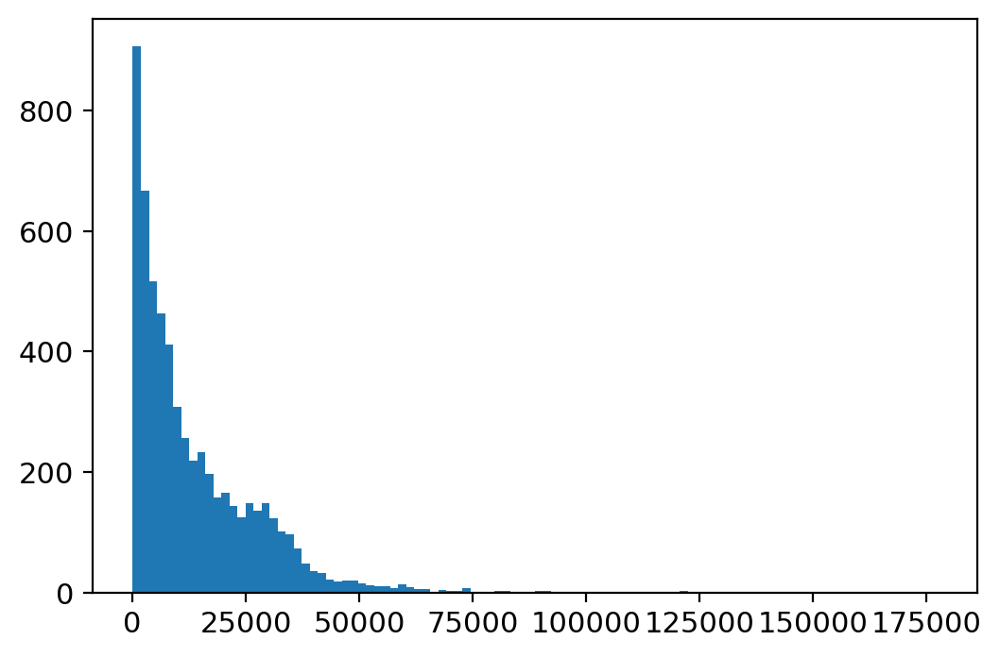

In [8]:
plt.hist(adata_atac_.X.sum(1), bins=100);

In [9]:
sc.pp.filter_cells(adata_atac_, min_counts=5000)

In [10]:
adata_ = sc.read_10x_mtx('filtered_feature_bc_matrix/', var_names='gene_symbols', cache=True, gex_only=True)
adata_.var_names_make_unique()

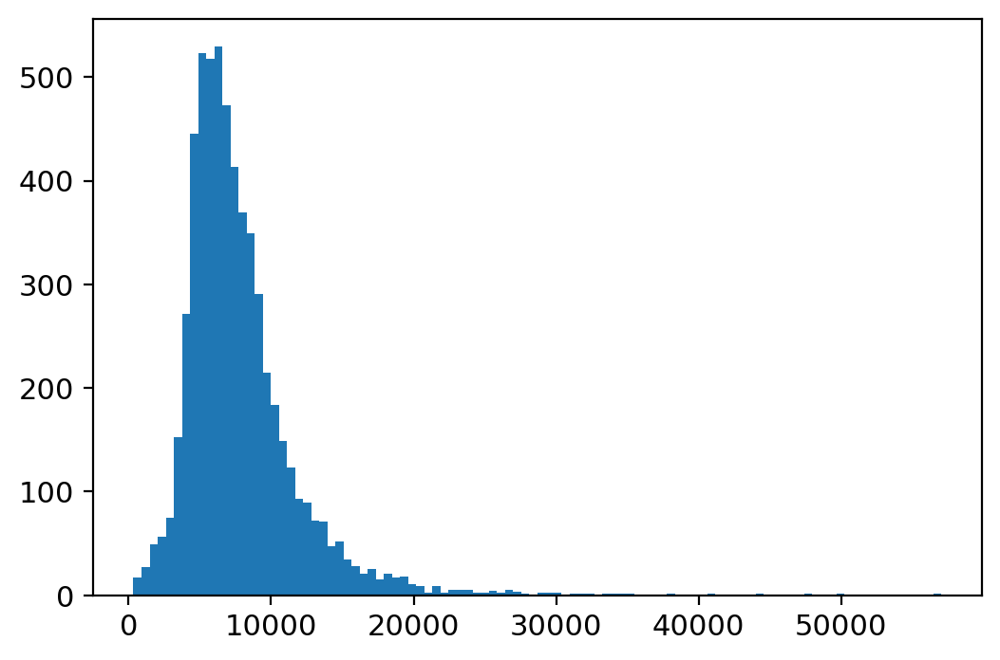

In [11]:
plt.hist(adata_.X.sum(1), bins=100);

In [12]:
sc.pp.filter_cells(adata_, min_genes=500)
sc.pp.filter_genes(adata_, min_cells=10)

In [13]:
adata_.var['mt'] = adata_.var_names.str.startswith('MT-')
adata_.var['rb'] = adata_.var_names.str.startswith(('RPS', 'RPL'))
adata_.var['hla'] = adata_.var_names.str.startswith('HLA-')
adata_.var['hb'] = np.in1d(adata_.var_names, hb_genes)
sc.pp.calculate_qc_metrics(adata_, qc_vars=['mt', 'rb', 'hla', 'hb'], percent_top=[20], log1p=True, inplace=True)

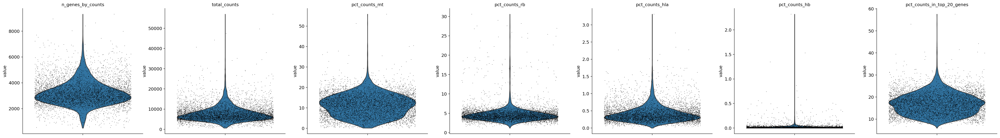

In [14]:
sc.pl.violin(adata_, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_rb', 'pct_counts_hla', 'pct_counts_hb', 'pct_counts_in_top_20_genes'], jitter=0.4, multi_panel=True)

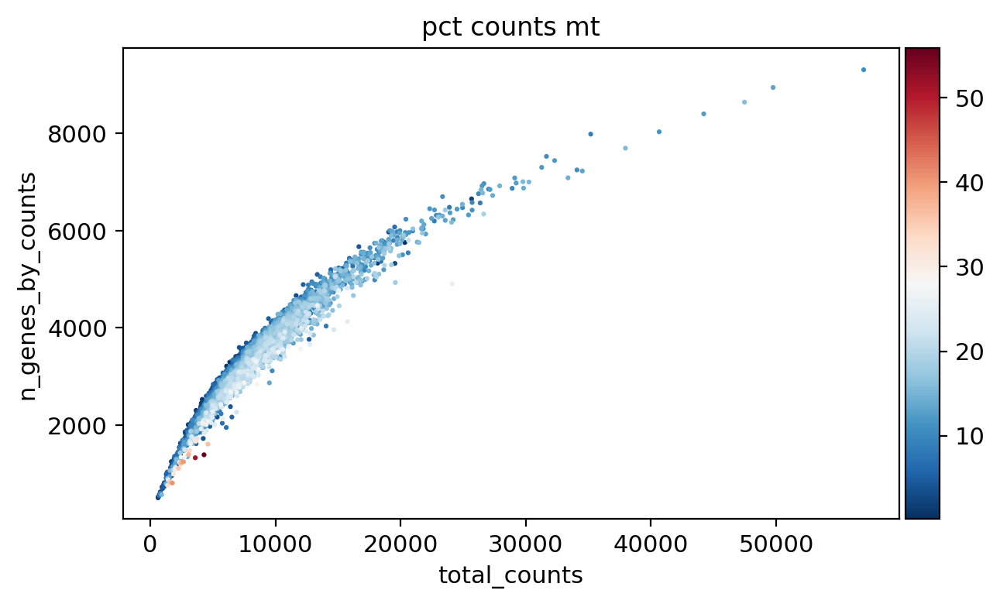

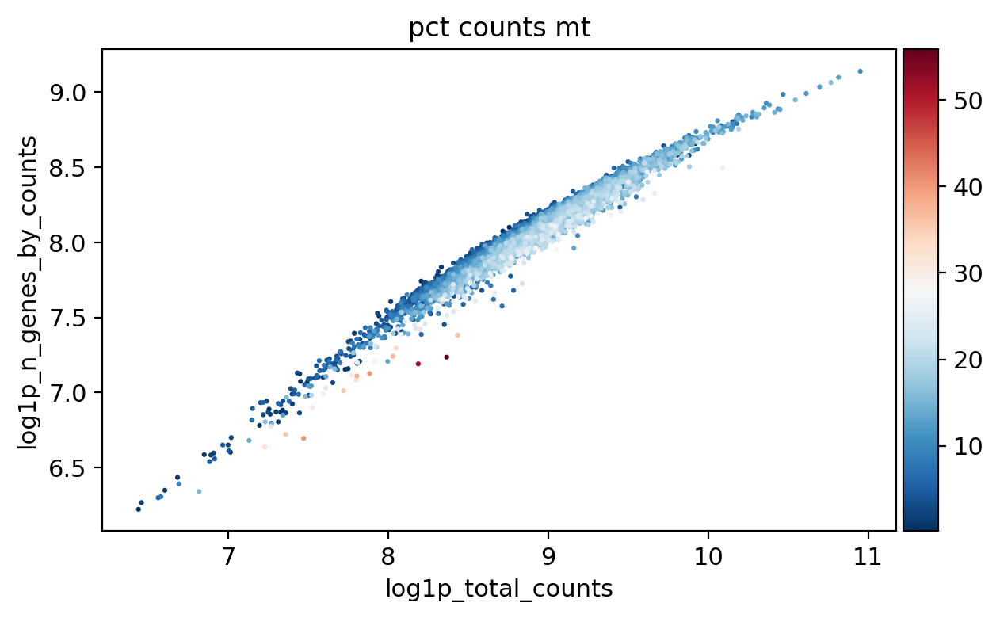

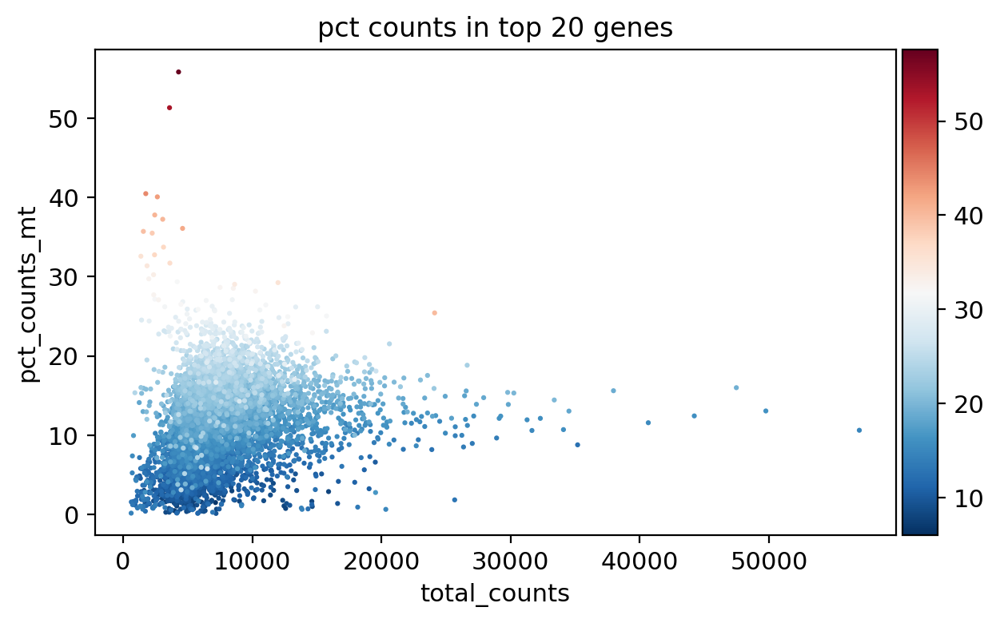

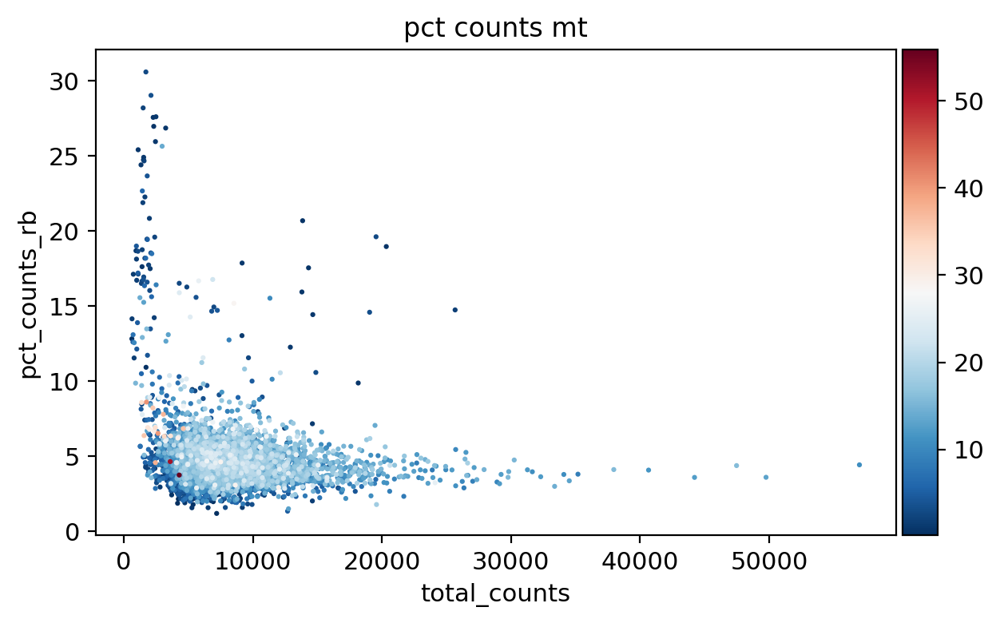

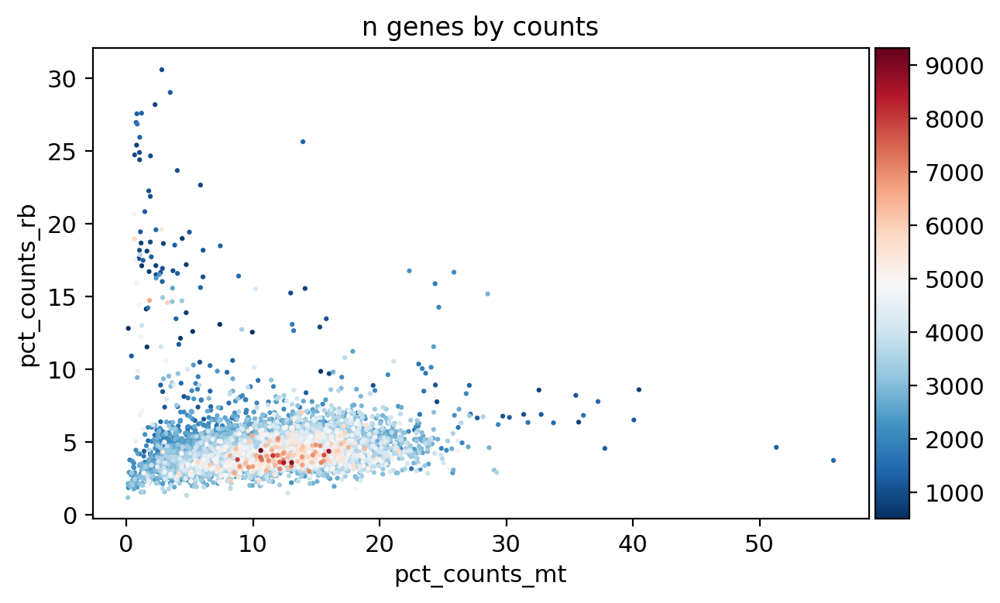

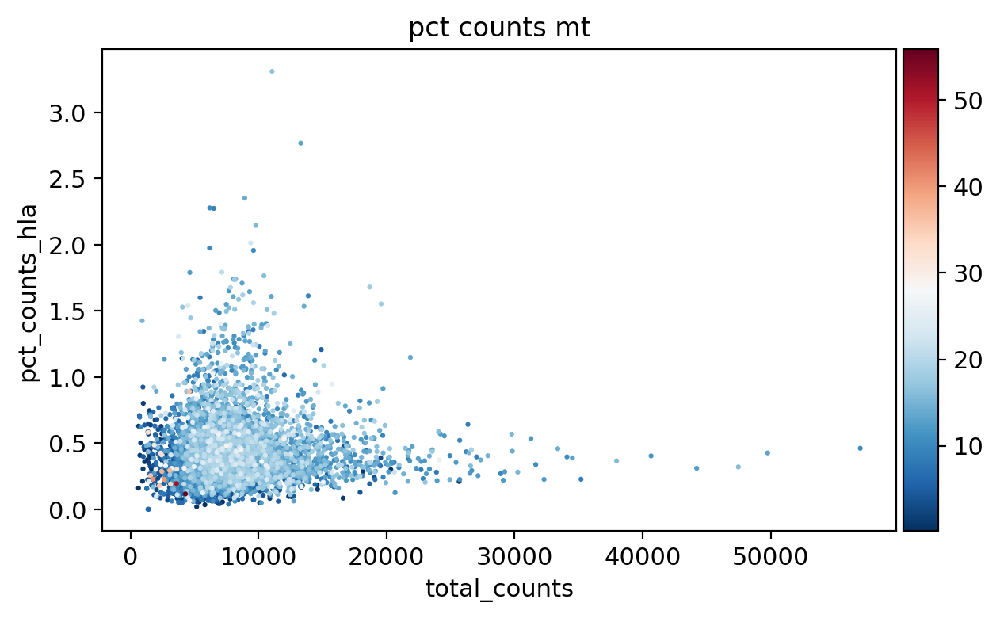

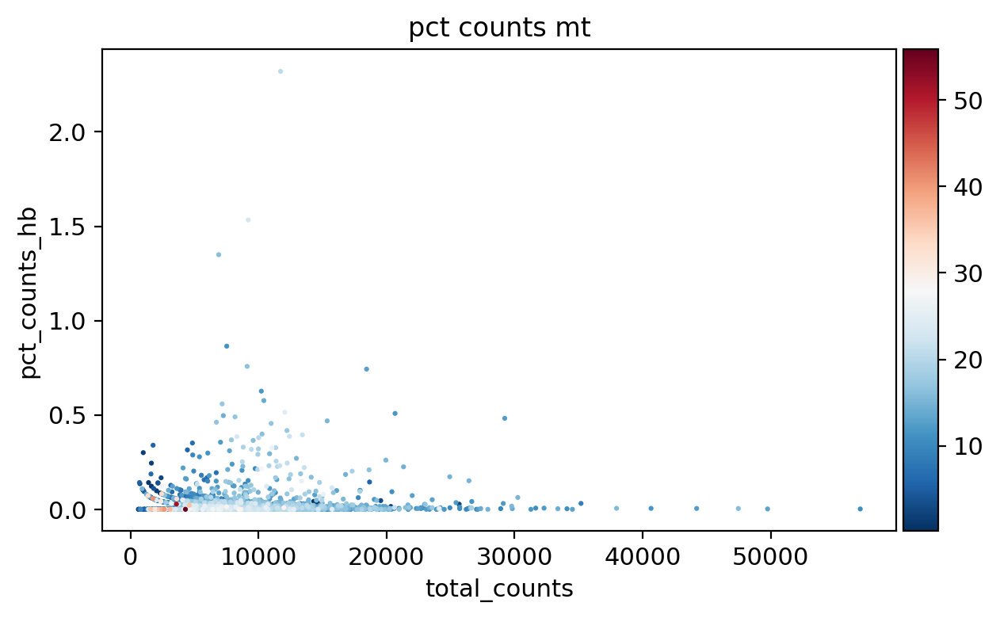

In [15]:
sc.pl.scatter(adata_, x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')
sc.pl.scatter(adata_, x='log1p_total_counts', y='log1p_n_genes_by_counts', color='pct_counts_mt')
sc.pl.scatter(adata_, x='total_counts', y='pct_counts_mt', color='pct_counts_in_top_20_genes')
sc.pl.scatter(adata_, x='total_counts', y='pct_counts_rb', color='pct_counts_mt')
sc.pl.scatter(adata_, x='pct_counts_mt', y='pct_counts_rb', color='n_genes_by_counts')
sc.pl.scatter(adata_, x='total_counts', y='pct_counts_hla', color='pct_counts_mt')
sc.pl.scatter(adata_, x='total_counts', y='pct_counts_hb', color='pct_counts_mt')

total_counts lower_bound 3051.2736873585536, upper_bound 20557.138048515284
n_genes_by_counts lower_bound 1848.8445262580622, upper_bound 6017.457141650011
pct_counts_in_top_20_genes lower_bound 5.964653902798233, upper_bound 30.443945494607963
pct_counts_mt lower_bound 0.1251564472913742, upper_bound 22.921123027801514
pct_counts_rb lower_bound 2.155751347541809, upper_bound 7.205443859100342


False    5381
True      527
Name: outlier, dtype: int64

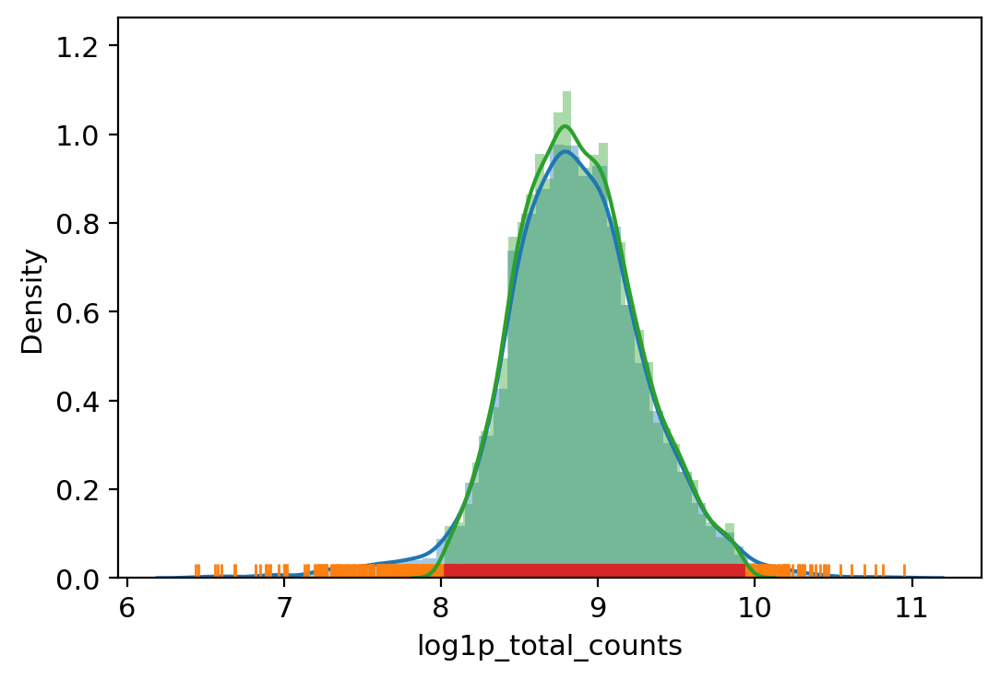

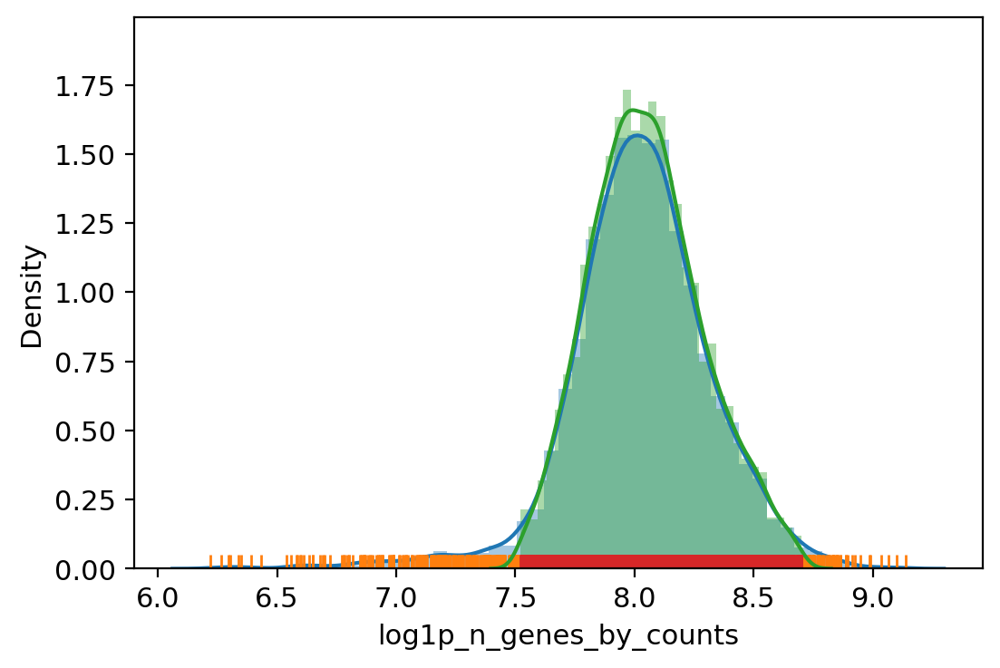

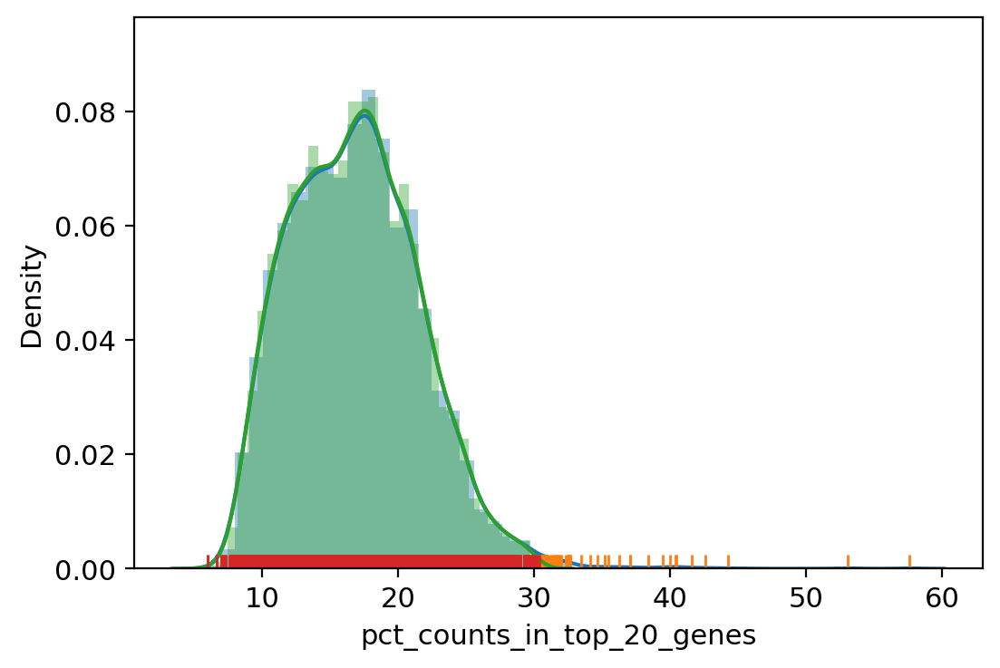

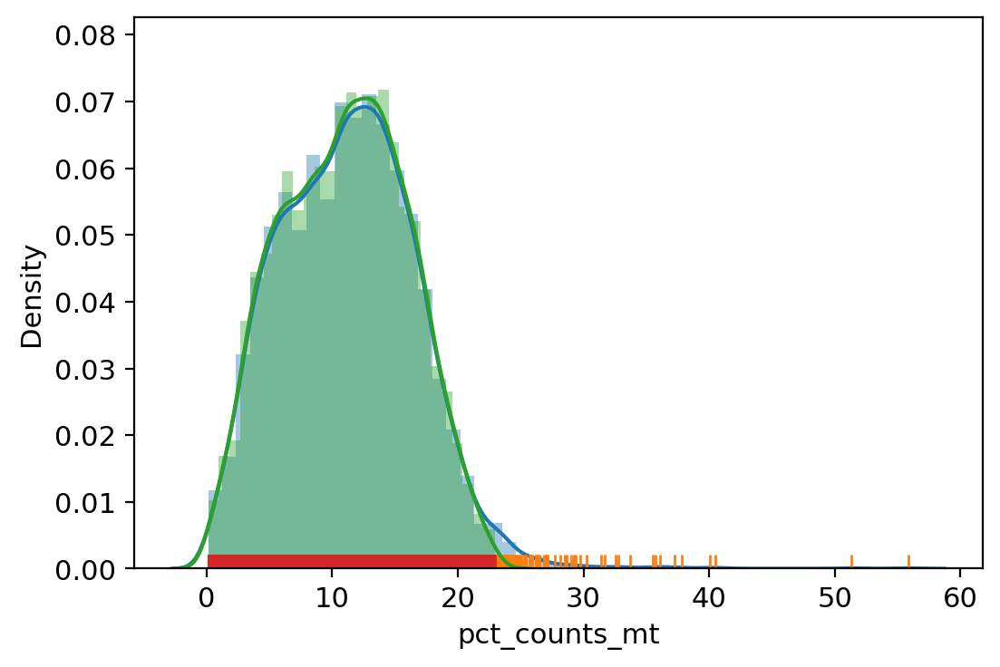

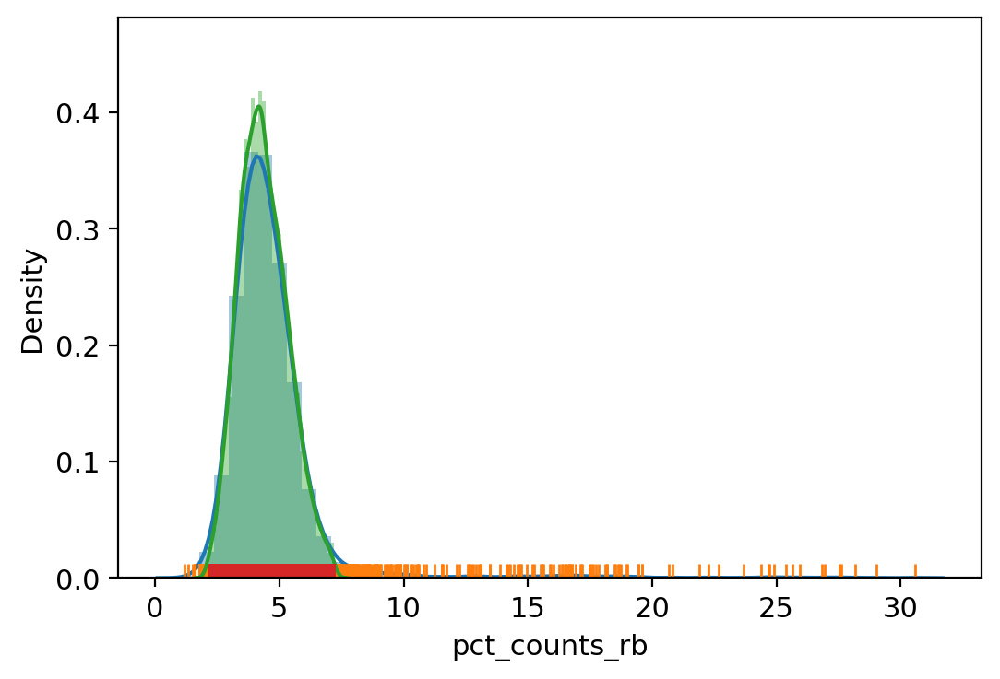

In [16]:
adata_.obs["outlier"] = (
    vv.is_outlier(adata_, "log1p_total_counts", 3, 4)
    | vv.is_outlier(adata_, "log1p_n_genes_by_counts", 3, 4)
    | vv.is_outlier(adata_, "pct_counts_in_top_20_genes", 4, 4)
    | vv.is_outlier(adata_, "pct_counts_mt", 4, 3)
    | vv.is_outlier(adata_, "pct_counts_rb", 3, 4)
)
adata_.obs.outlier.value_counts()

In [17]:
adata_ = adata_[~adata_.obs.outlier].copy()
adata_

AnnData object with n_obs × n_vars = 5381 × 20899
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [18]:
sc.pp.filter_genes(adata_, min_counts=20)

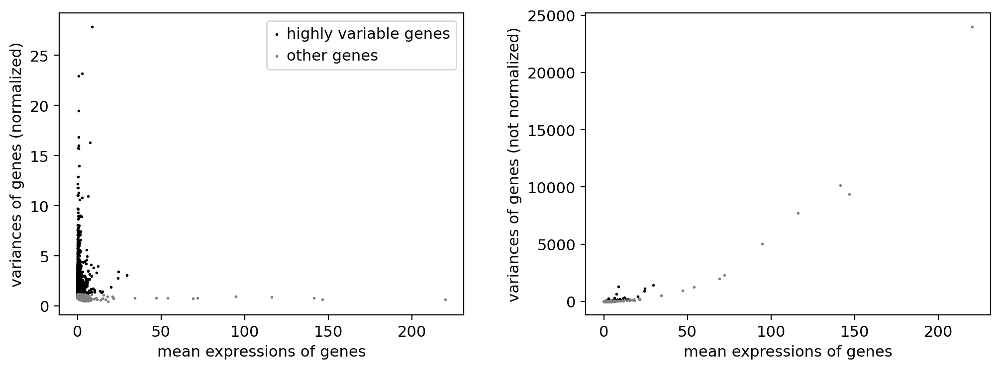

In [19]:
sc.pp.highly_variable_genes(adata_, n_top_genes=3000, flavor="seurat_v3")
sc.pl.highly_variable_genes(adata_)

In [20]:
np.sum(adata_.var.highly_variable)

3000

In [21]:
adata = sc.read_10x_mtx('starsolo-filtered/', var_names='gene_symbols', make_unique=True, cache=True, gex_only=True)
adata.layers['unspliced'] = sc.read_10x_mtx('starsolo-filtered/', prefix='unspliced_', var_names='gene_symbols', make_unique=True, cache=True, gex_only=True).X
adata.layers['spliced'] = sc.read_10x_mtx('starsolo-filtered/', prefix='spliced_', var_names='gene_symbols', make_unique=True, cache=True, gex_only=True).X
adata.obs_names = [x + '-1' for x in adata.obs_names]

In [22]:
shared_cells = np.intersect1d(adata.obs_names, adata_.obs_names)
adata = adata[shared_cells,:]
adata

View of AnnData object with n_obs × n_vars = 5381 × 36601
    var: 'gene_ids', 'feature_types'
    layers: 'unspliced', 'spliced'

In [23]:
adata.var['HVG'] = False
adata.var.loc[adata_.var_names[adata_.var.highly_variable], 'HVG'] = True

In [24]:
sc.pp.filter_genes(adata, min_cells=10)

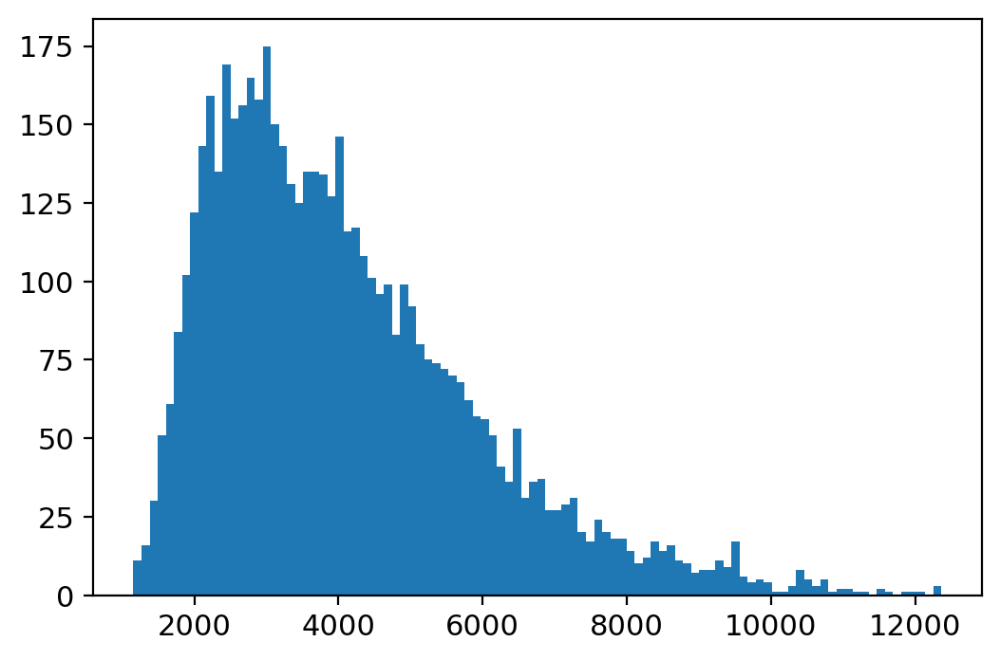

In [25]:
plt.hist(adata.X.sum(1), bins=100);

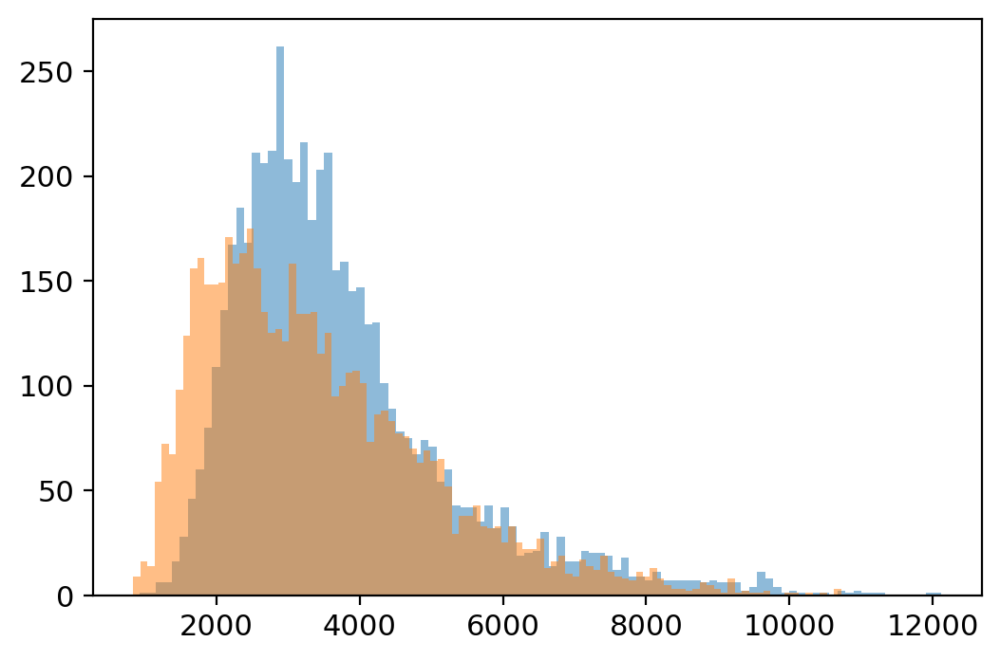

In [26]:
plt.hist(adata.layers['unspliced'].sum(1), bins=100, alpha=0.5);
plt.hist(adata.layers['spliced'].sum(1), bins=100, alpha=0.5);

In [27]:
counts_u = adata.layers['unspliced'].sum(1).A1
counts_s = adata.layers['spliced'].sum(1).A1
adata.obs['total_unspliced'] = counts_u
adata.obs['total_spliced'] = counts_s
adata.obs['log1p_total_unspliced'] = np.log1p(counts_u)
adata.obs['log1p_total_spliced'] = np.log1p(counts_s)
adata.obs['fraction_u'] = counts_u / (counts_s + counts_u)

In [28]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')
adata.var['rb'] = adata.var_names.str.startswith(('RPS', 'RPL'))
adata.var['hla'] = adata.var_names.str.startswith('HLA-')
adata.var['hb'] = np.in1d(adata.var_names, hb_genes)
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt', 'rb', 'hla', 'hb'], percent_top=[20], log1p=True, inplace=True)

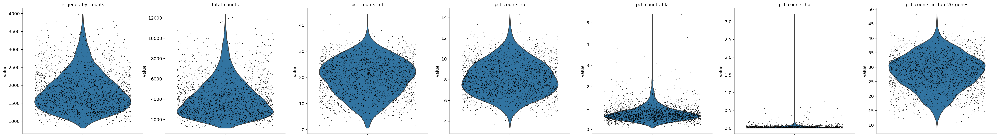

In [29]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_rb', 'pct_counts_hla', 'pct_counts_hb', 'pct_counts_in_top_20_genes'], jitter=0.4, multi_panel=True)

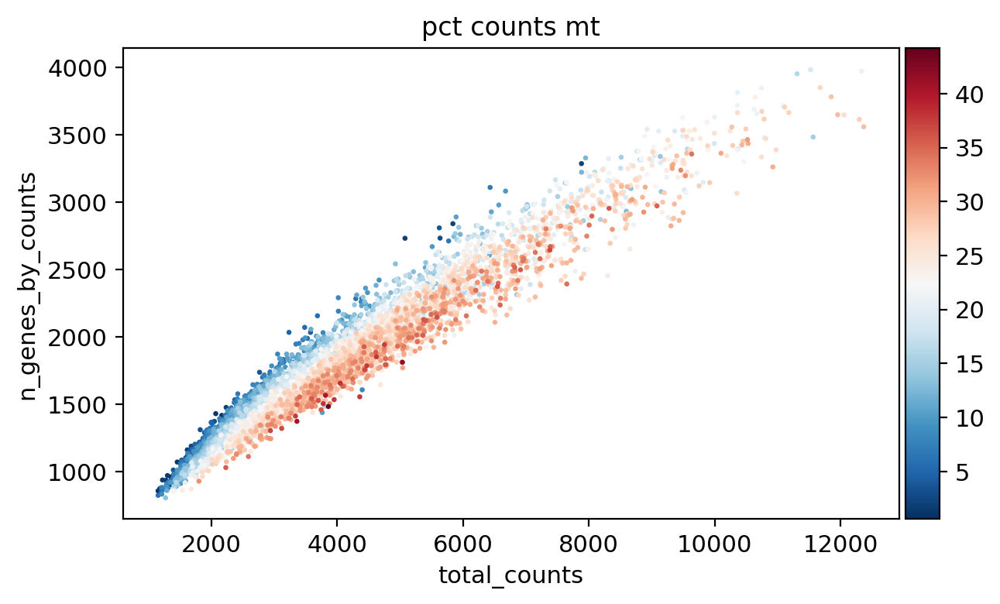

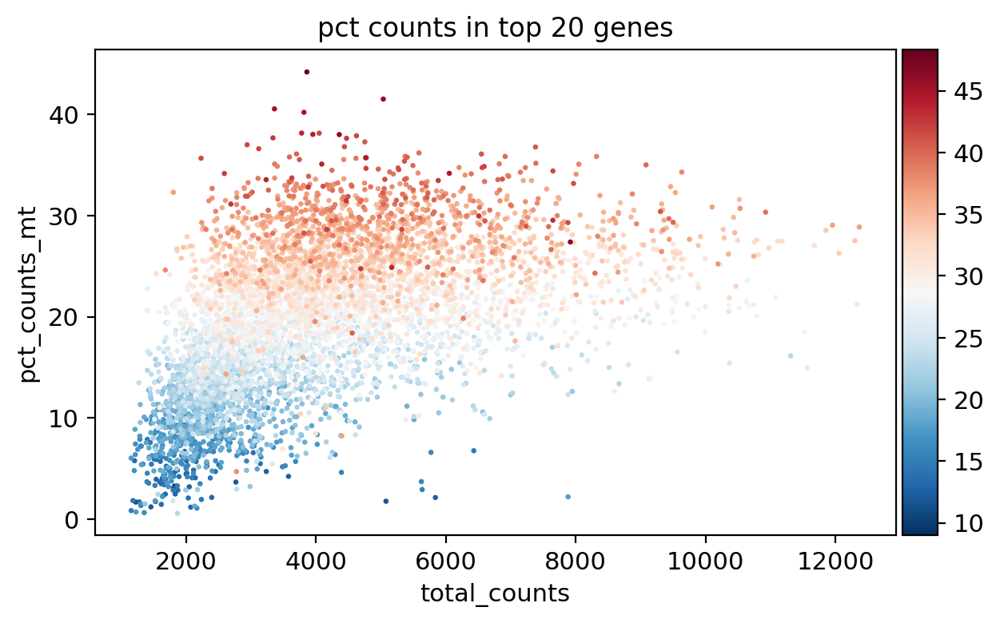

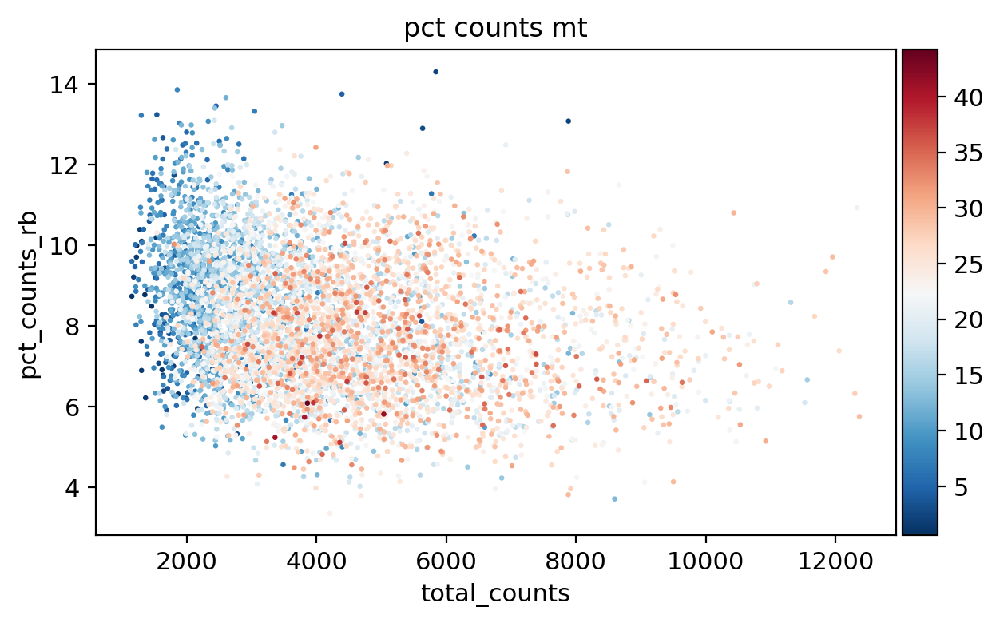

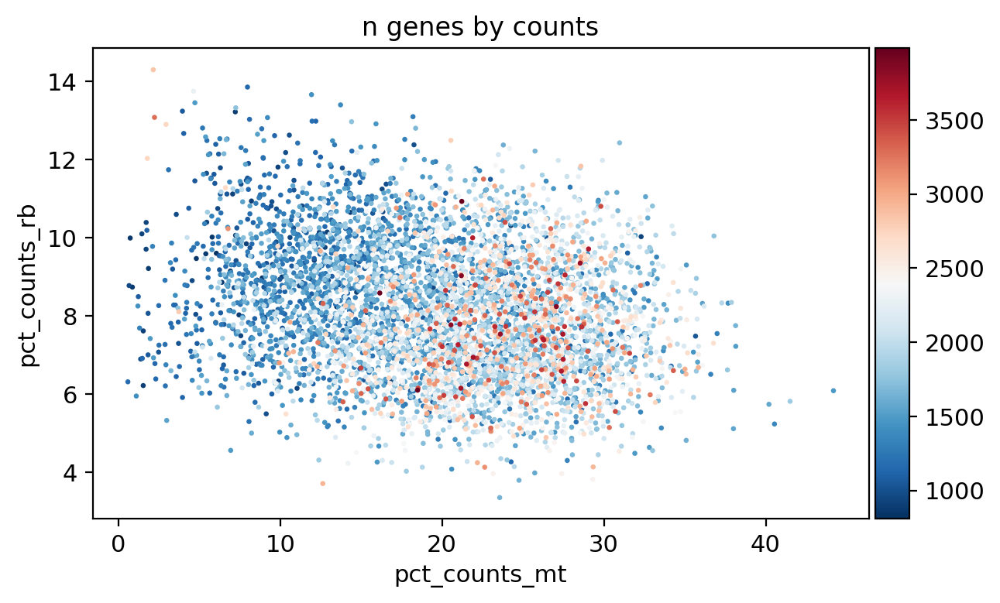

In [30]:
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', color='pct_counts_in_top_20_genes')
sc.pl.scatter(adata, x='total_counts', y='pct_counts_rb', color='pct_counts_mt')
sc.pl.scatter(adata, x='pct_counts_mt', y='pct_counts_rb', color='n_genes_by_counts')

total_counts lower_bound 1429.8891202028626, upper_bound 12367.0
total_unspliced lower_bound 1282.6233407579366, upper_bound 11366.669916049814
total_spliced lower_bound 838.9998779296875, upper_bound 10721.001953125
pct_counts_mt lower_bound 0.5885500311851501, upper_bound 35.96246910095215
pct_counts_rb lower_bound 4.462307453155518, upper_bound 12.810439109802246


False    5270
True      111
Name: outlier, dtype: int64

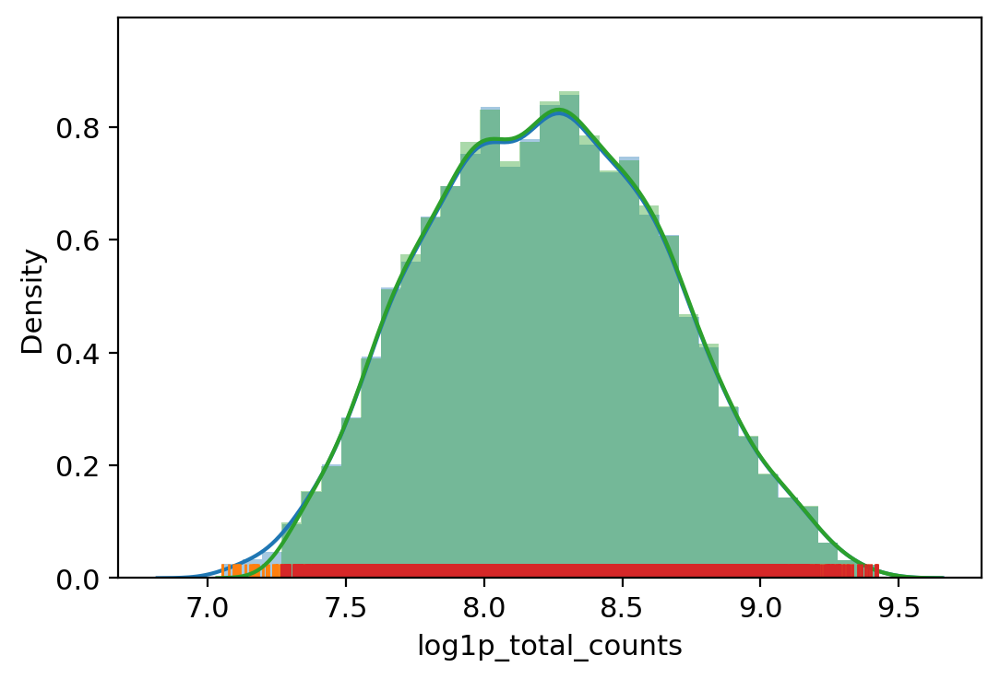

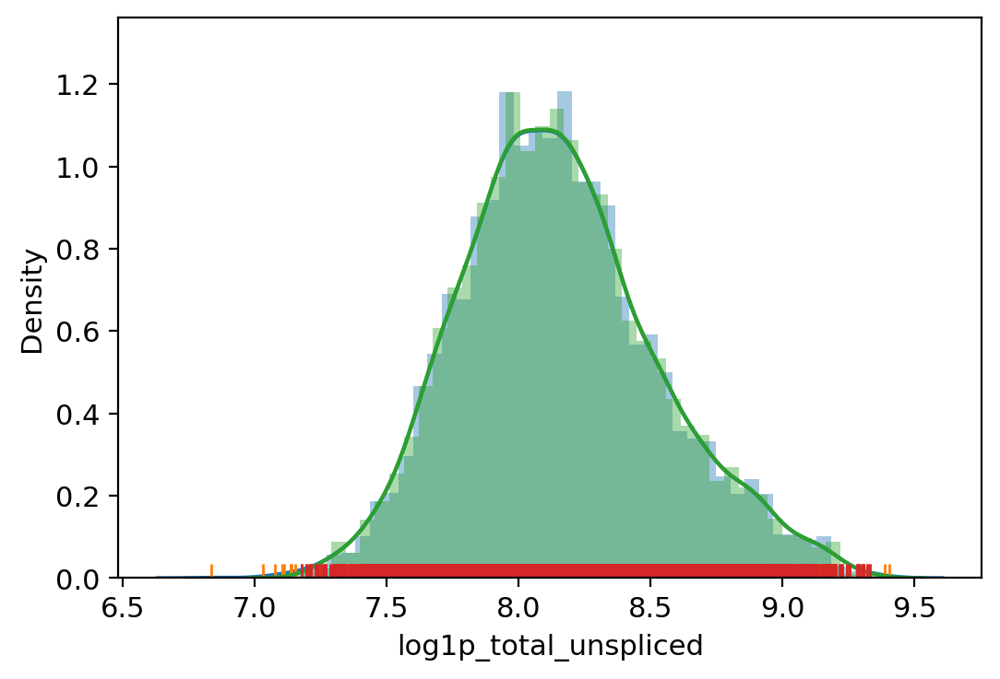

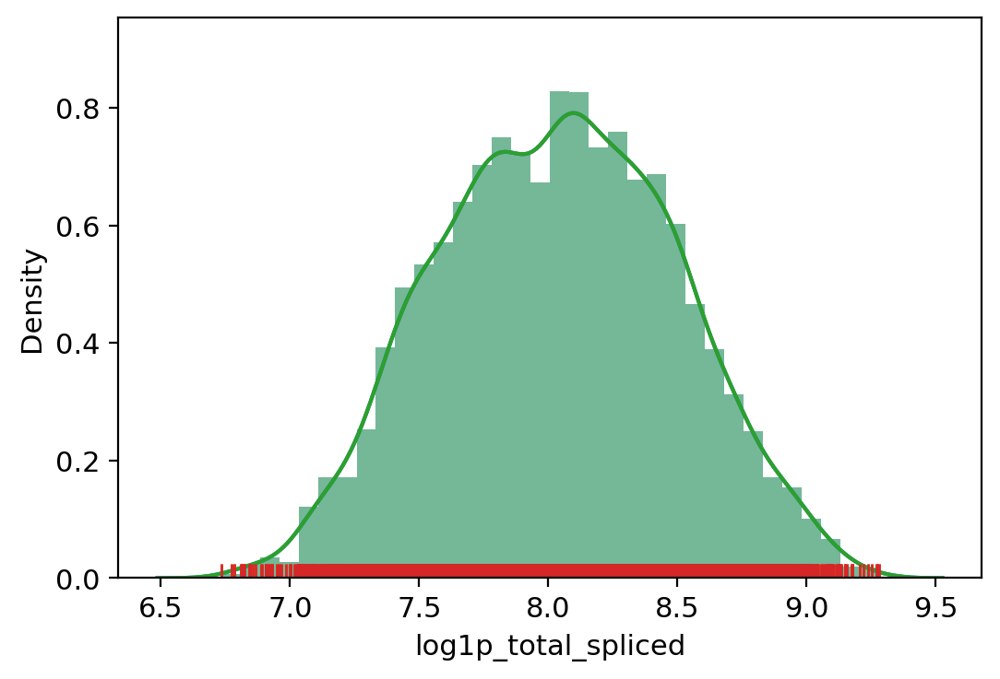

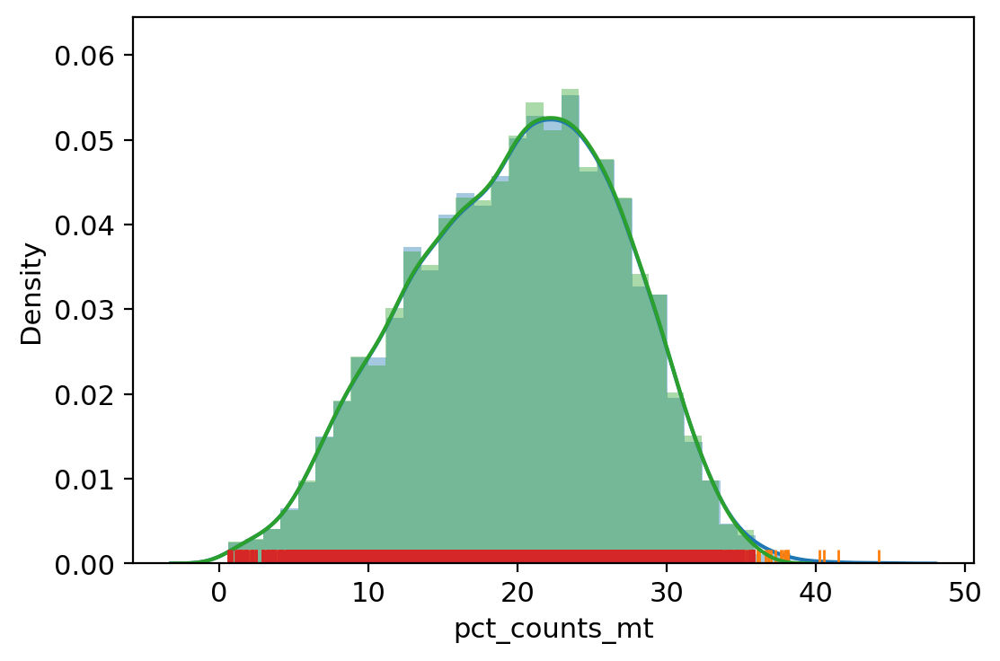

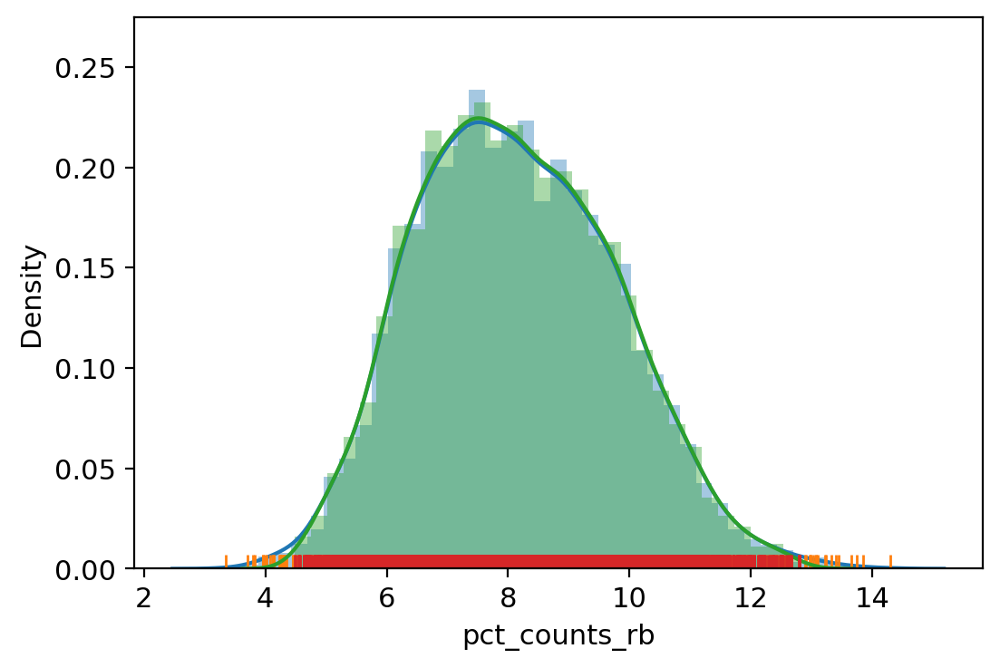

In [31]:
adata.obs["outlier"] = (
    vv.is_outlier(adata, "log1p_total_counts", 3, 4)
    | vv.is_outlier(adata, "log1p_total_unspliced", 4, 5)
    | vv.is_outlier(adata, "log1p_total_spliced", 4, 5)
    | vv.is_outlier(adata, "pct_counts_mt", 4, 3)
    | vv.is_outlier(adata, "pct_counts_rb", 3, 4)
)
adata.obs.outlier.value_counts()

In [32]:
adata = adata[~adata.obs.outlier].copy()
adata

AnnData object with n_obs × n_vars = 5270 × 15970
    obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier'
    var: 'gene_ids', 'feature_types', 'HVG', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'unspliced', 'spliced'

In [33]:
scv.pp.filter_genes(adata, min_shared_counts=20)
shared_genes = np.intersect1d(adata.var_names, adata_atac_.var_names)
adata = adata[:, shared_genes]
adata

Filtered out 7440 genes that are detected 20 counts (shared).


View of AnnData object with n_obs × n_vars = 5270 × 8223
    obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size'
    var: 'gene_ids', 'feature_types', 'HVG', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'unspliced', 'spliced'

fraction_u lower_bound 0.26220929622650146, upper_bound 0.7760594487190247


False    5270
Name: outlier, dtype: int64

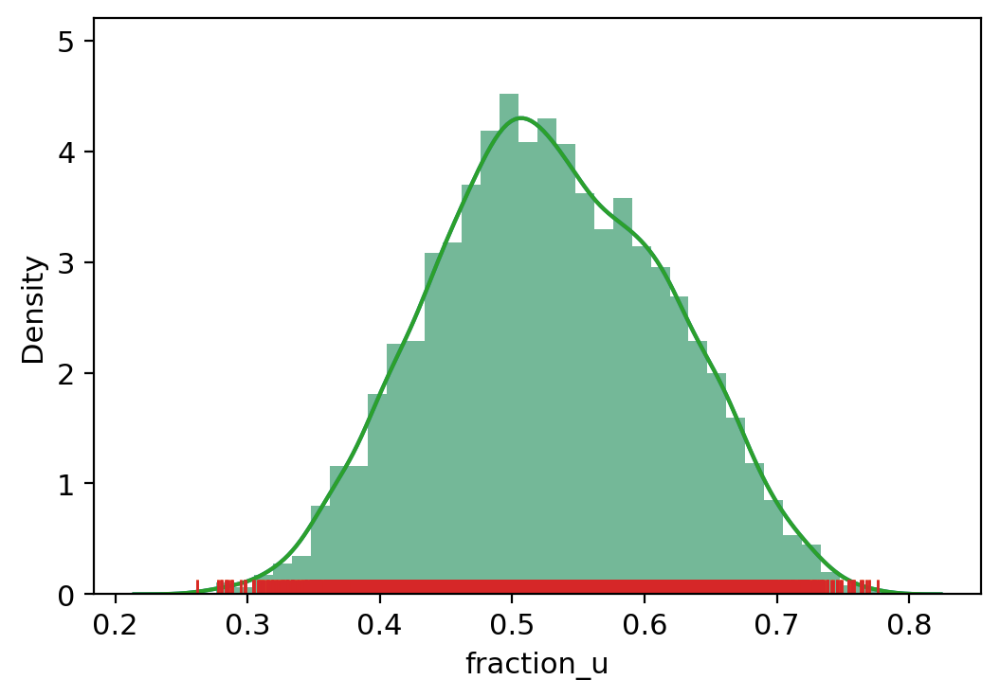

In [34]:
adata.obs["outlier"] = (
    vv.is_outlier(adata, "fraction_u")
)
adata.obs.outlier.value_counts()

In [35]:
shared_cells = pd.Index(np.intersect1d(adata.obs_names, adata_atac_.obs_names))
shared_genes = pd.Index(np.intersect1d(adata.var_names, adata_atac_.var_names))
shared_cells, shared_genes

(Index(['AAACAGCCAGTAGGAT-1', 'AAACAGCCATCCTAGA-1', 'AAACATGCACACAATT-1',
        'AAACATGCATAGGCGA-1', 'AAACATGCATGAAATG-1', 'AAACCAACAACTGGGA-1',
        'AAACCAACAAGTGTTT-1', 'AAACCAACATGTTTGG-1', 'AAACCGAAGCGCCTTT-1',
        'AAACCGAAGCGGGCAA-1',
        ...
        'TTTGTCCCAACTAACT-1', 'TTTGTCCCACCGGTAT-1', 'TTTGTCCCAGCTTAGC-1',
        'TTTGTCCCAGGCTAAG-1', 'TTTGTCCCAGGCTAGA-1', 'TTTGTGGCAAGGTCCT-1',
        'TTTGTGGCAGCATGAG-1', 'TTTGTGGCATCCTGAA-1', 'TTTGTGTTCATCAGTA-1',
        'TTTGTTGGTTGGATCA-1'],
       dtype='object', length=3572),
 Index(['AACS', 'AAGAB', 'AAK1', 'AAMDC', 'AARS', 'AARSD1', 'AASDH', 'AASDHPPT',
        'AASS', 'AATF',
        ...
        'ZSWIM7', 'ZSWIM8', 'ZSWIM9', 'ZUP1', 'ZW10', 'ZWILCH', 'ZXDC',
        'ZYG11B', 'ZYX', 'ZZEF1'],
       dtype='object', length=8223))

In [36]:
adata = adata[shared_cells, shared_genes]
adata_atac = adata_atac_[shared_cells, shared_genes]

In [37]:
adata.write_h5ad('9060-MV-3_adata_prepro.h5ad')
adata_atac.write_h5ad('9060-MV-3_adata_atac_prepro.h5ad')

In [38]:
adata = sc.read_h5ad('9060-MV-3_adata_prepro.h5ad')
adata_atac = sc.read_h5ad('9060-MV-3_adata_atac_prepro.h5ad')

In [39]:
adata

AnnData object with n_obs × n_vars = 3572 × 8223
    obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size'
    var: 'gene_ids', 'feature_types', 'HVG', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'spliced', 'unspliced'

In [40]:
vv.model.tfidf_norm(adata_atac)

In [41]:
scv.pp.normalize_per_cell(adata)

Normalized count data: X, spliced, unspliced.


In [42]:
s_genes_list_sub = s_genes_list[np.isin(s_genes_list, adata.var_names)]
g2m_genes_list_sub = g2m_genes_list[np.isin(g2m_genes_list, adata.var_names)]
scv.tl.score_genes_cell_cycle(adata, s_genes=s_genes_list_sub, g2m_genes=g2m_genes_list_sub)

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


In [43]:
adata_copy = adata.copy()

In [44]:
vv.regress_out(adata_copy, ['S_score', 'G2M_score'], add_intercept=True)

Extracted 1400 highly variable genes.


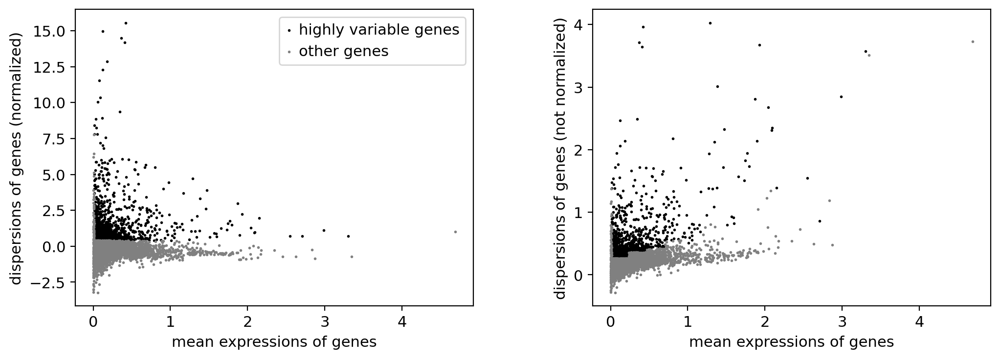

In [45]:
vv.filter_genes_dispersion(adata_copy, min_mean=0.0125, max_mean=4, min_disp=0.4, subset=False)
sc.pl.highly_variable_genes(adata_copy)

In [46]:
if 'PROM1' in adata_copy.var_names:
    print(adata_copy[:, 'PROM1'].var)

              gene_ids    feature_types   HVG  n_cells     mt     rb    hla  \
PROM1  ENSG00000007062  Gene Expression  True      332  False  False  False   

          hb  n_cells_by_counts  mean_counts  log1p_mean_counts  \
PROM1  False                332     0.079911           0.076878   

       pct_dropout_by_counts  total_counts  log1p_total_counts  \
PROM1              93.830143         430.0            6.066108   

       gene_count_corr     means  dispersions  dispersions_norm  \
PROM1           0.0684  0.071112     0.146076         -0.381486   

       highly_variable  
PROM1            False  


In [47]:
np.sum(adata_copy.var.highly_variable), np.sum(adata_copy.var.HVG), np.sum(adata_copy.var.highly_variable & adata_copy.var.HVG)

(1400, 1541, 744)

In [48]:
sc.pp.log1p(adata)

In [49]:
scv.tl.score_genes_cell_cycle(adata, s_genes=s_genes_list_sub, g2m_genes=g2m_genes_list_sub)
adata.obs['CC_difference'] = adata.obs['S_score'] - adata.obs['G2M_score']
len(s_genes_list_sub), len(g2m_genes_list_sub)

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


(41, 49)

In [50]:
counts_u = adata.layers['unspliced'].sum(1).A1
counts_s = adata.layers['spliced'].sum(1).A1
adata.obs['total_unspliced'] = counts_u
adata.obs['total_spliced'] = counts_s
adata.obs['log1p_total_unspliced'] = np.log1p(counts_u)
adata.obs['log1p_total_spliced'] = np.log1p(counts_s)
adata.obs['fraction_u'] = counts_u / (counts_s + counts_u)

In [51]:
adata = adata[:, adata_copy.var.highly_variable & adata_copy.var.HVG]
adata.var['highly_variable'] = True

In [52]:
adata_atac = adata_atac[adata.obs_names, adata.var_names]

In [53]:
adata

AnnData object with n_obs × n_vars = 3572 × 744
    obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'S_score', 'G2M_score', 'phase', 'CC_difference'
    var: 'gene_ids', 'feature_types', 'HVG', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'gene_count_corr', 'highly_variable'
    uns: 'log1p'
    layers: 'spliced', 'unspliced'

In [54]:
counts_u = adata.layers['unspliced'].sum(1).A1
counts_s = adata.layers['spliced'].sum(1).A1
adata.obs['total_unspliced2'] = counts_u
adata.obs['total_spliced2'] = counts_s
adata.obs['log1p_total_unspliced2'] = np.log1p(counts_u)
adata.obs['log1p_total_spliced2'] = np.log1p(counts_s)
adata.obs['fraction_u2'] = counts_u / (counts_s + counts_u)

In [55]:
sc.pp.regress_out(adata, ['CC_difference'])

In [56]:
sc.pp.scale(adata)

In [57]:
scv.pp.moments(adata, n_pcs=30, n_neighbors=50)

computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [58]:
scv.tl.umap(adata)

In [59]:
adata.obs['n_c'] = adata_atac.X.sum(1)
adata.obs['n_Mu'] = np.sum(adata.layers['Mu'], 1)
adata.obs['n_Ms'] = np.sum(adata.layers['Ms'], 1)

/home/chen/.mambaforge/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


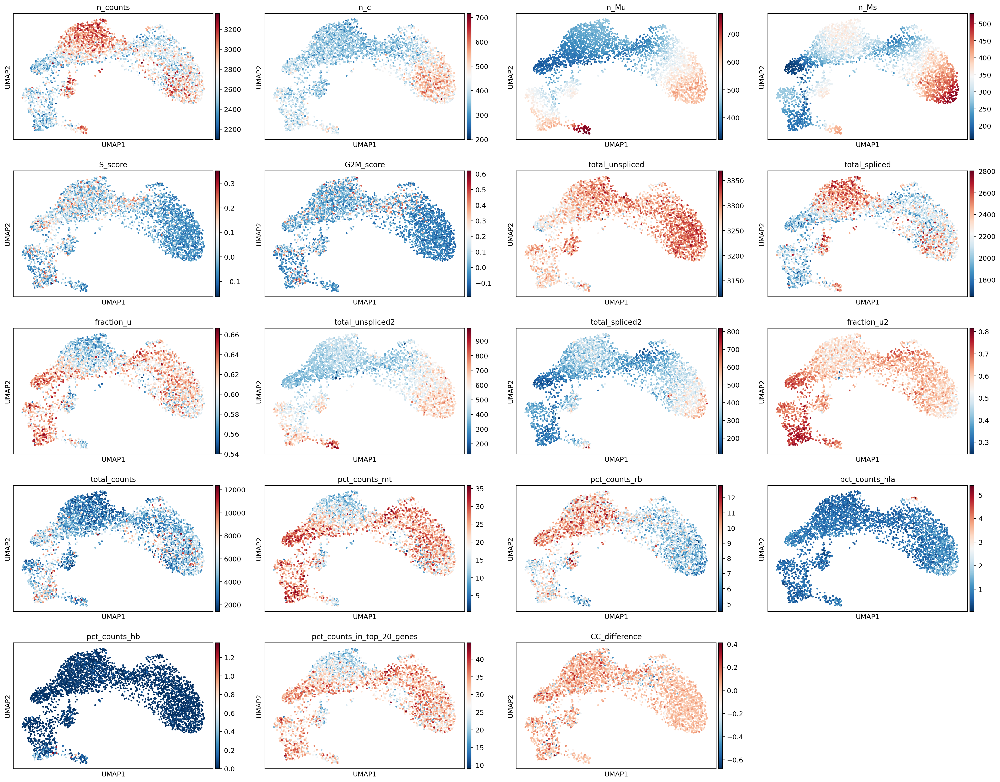

In [60]:
sc.pl.umap(adata, color=['n_counts', 'n_c', 'n_Mu', 'n_Ms',
                         'S_score', 'G2M_score', 'total_unspliced', 'total_spliced',
                         'fraction_u', 'total_unspliced2', 'total_spliced2', 'fraction_u2',
                         'total_counts', 'pct_counts_mt', 'pct_counts_rb', 'pct_counts_hla',
                         'pct_counts_hb', 'pct_counts_in_top_20_genes', 'CC_difference'])

/home/chen/.mambaforge/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


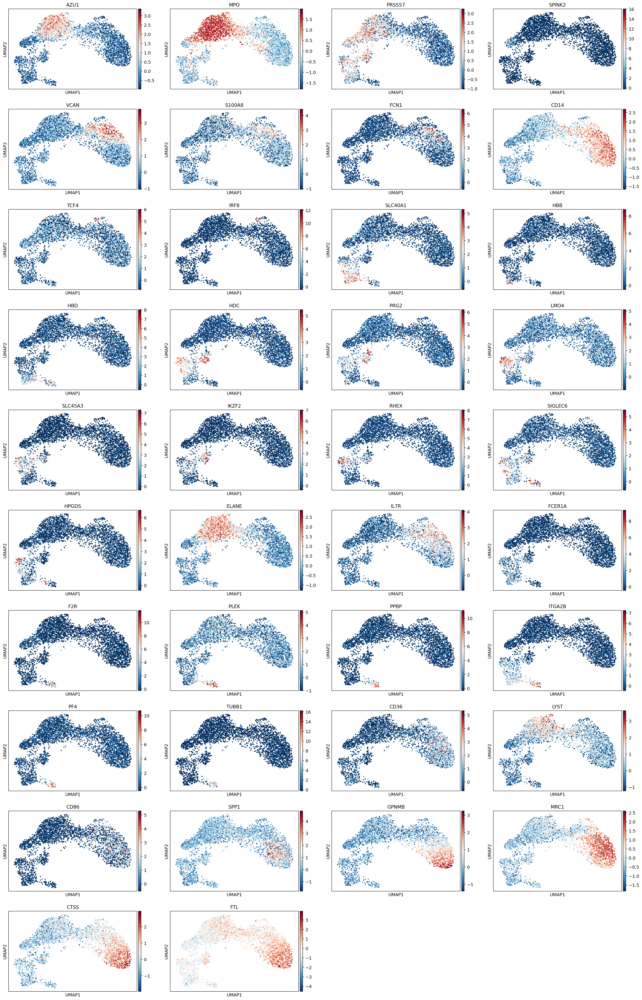

In [61]:
mg = marker_genes[np.isin(marker_genes, adata.var_names)]
sc.pl.umap(adata, color=mg)

/home/chen/.mambaforge/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


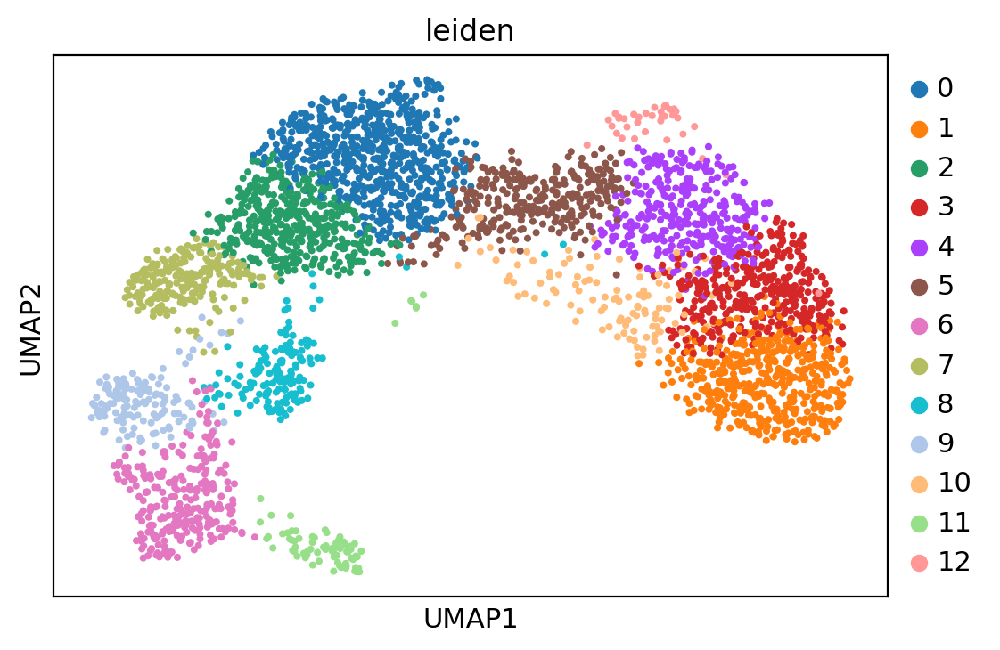

In [62]:
sc.tl.leiden(adata, resolution=1.6)
sc.pl.umap(adata, color='leiden')

/home/chen/.mambaforge/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


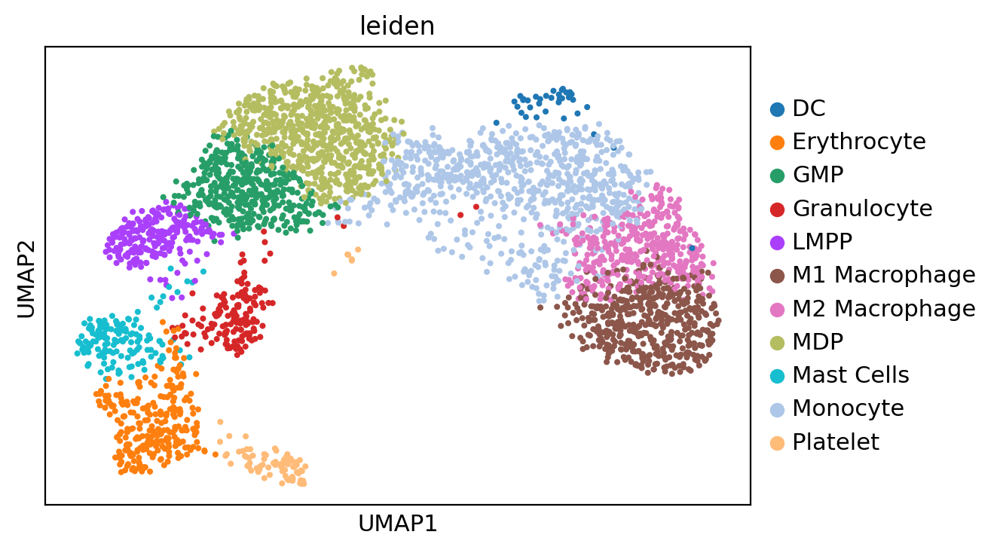

In [63]:
new_cluster_names = ['MDP',
                     'M1 Macrophage',
                     'GMP',
                     'M2 Macrophage',
                     'Monocyte 1',
                     'Monocyte 2',
                     'Erythrocyte',
                     'LMPP',
                     'Granulocyte',
                     'Mast Cells',
                     'Monocyte 3',
                     'Platelet',
                     'DC']
adata.rename_categories('leiden', new_cluster_names)
new_cluster_names = adata.obs['leiden'].to_numpy()
new_cluster_names[(new_cluster_names == 'Monocyte 1') | (new_cluster_names == 'Monocyte 2') | (new_cluster_names == 'Monocyte 3')] = 'Monocyte'
adata.obs['leiden'] = new_cluster_names
sc.pl.umap(adata, color='leiden')

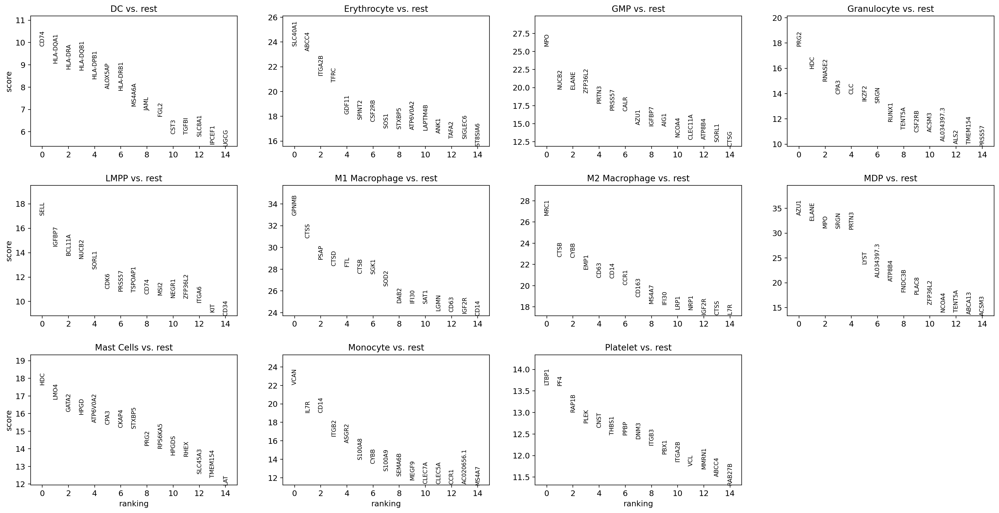

In [64]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

In [65]:
adata

AnnData object with n_obs × n_vars = 3572 × 744
    obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'S_score', 'G2M_score', 'phase', 'CC_difference', 'total_unspliced2', 'total_spliced2', 'log1p_total_unspliced2', 'log1p_total_spliced2', 'fraction_u2', 'n_c', 'n_Mu', 'n_Ms', 'leiden'
    var: 'gene_ids', 'feature_types', 'HVG', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'gene_c

In [66]:
with open('filtered_cells.txt', 'w', newline ='') as f:
    writer = csv.writer(f, delimiter=',')
    writer.writerows(adata_atac.obs_names[:,None])
with open('leiden.txt', 'w', newline ='') as f:
    writer = csv.writer(f, delimiter=',')
    writer.writerows(np.array(adata.obs['leiden'].values)[:,None])

In [67]:
# Run seurat_wnn.R

In [68]:
nn_idx = np.loadtxt("seurat/nn_idx.txt", delimiter=',')
nn_dist = np.loadtxt("seurat/nn_dist.txt", delimiter=',')
nn_cell_names = list(pd.read_csv("seurat/nn_cell_names.txt", header=None)[0])
nn_idx.shape

(3572, 50)

In [69]:
np.all(nn_cell_names == adata.obs_names)

True

In [70]:
adata_atac.obs['leiden'] = adata.obs['leiden']

In [71]:
vv.model.knn_smooth_chrom(adata_atac, nn_idx, nn_dist)

In [72]:
adata, adata_atac

(AnnData object with n_obs × n_vars = 3572 × 744
     obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'S_score', 'G2M_score', 'phase', 'CC_difference', 'total_unspliced2', 'total_spliced2', 'log1p_total_unspliced2', 'log1p_total_spliced2', 'fraction_u2', 'n_c', 'n_Mu', 'n_Ms', 'leiden'
     var: 'gene_ids', 'feature_types', 'HVG', 'n_cells', 'mt', 'rb', 'hla', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'gen

In [73]:
adata.write_h5ad('9060-MV-3_adata_postpro.h5ad')
adata_atac.write_h5ad('9060-MV-3_adata_atac_postpro.h5ad')